**Santander Customer Transaction Prediction**

**Note-all markdown in bold are main headings and stages of code.**

*Note-all markdown in inclined format are explaining part of code for better understandings*

In this project we need to identify which customers will make a specific transaction or not irrespective of the amount of money involved.

**Import and Setup**

In [30]:
import os
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import lightgbm as lgb
import eli5

from sklearn.model_selection import train_test_split, cross_val_predict, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from pdpbox import pdp
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve, classification_report, roc_curve, auc

random_state = 42
np.random.seed(random_state)
import warnings
warnings.filterwarnings('ignore')

In [3]:
#Setting working directory
os.chdir("C:/Users/jaina/Downloads/edu-versity advanced-intern-projects/Customer_transaction_prediction")

#saving plot to the results folder
save_dir = r"C:/Users/jaina\Downloads/edu-versity advanced-intern-projects/Customer_transaction_prediction/results(train&test_distributions)"
save_dir1 = r"C:/Users/jaina\Downloads/edu-versity advanced-intern-projects/Customer_transaction_prediction/results(train&test_distributions)/Distribution_test_train_per_column&row"
# Create folder if it doesn't exist
os.makedirs(save_dir, exist_ok=True)
os.makedirs(save_dir1, exist_ok=True)

In [4]:
os.getcwd()

'C:\\Users\\jaina\\Downloads\\edu-versity advanced-intern-projects\\Customer_transaction_prediction'

In [5]:
df_train = pd.read_csv("train.csv")
pd.options.display.max_columns = None

In [6]:
df_train.head()

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,5.7470,2.9252,3.1821,14.0137,0.5745,8.7989,14.5691,5.7487,-7.2393,4.2840,30.7133,10.5350,16.2191,2.5791,2.4716,14.3831,13.4325,-5.1488,-0.4073,4.9306,5.9965,-0.3085,12.9041,-3.8766,16.8911,11.1920,10.5785,0.6764,7.8871,4.6667,3.8743,-5.2387,7.3746,11.5767,12.0446,11.6418,-7.0170,5.9226,-14.2136,16.0283,5.3253,12.9194,29.0460,-0.6940,5.1736,-0.7474,14.8322,11.2668,5.3822,2.0183,10.1166,16.1828,4.9590,2.0771,-0.2154,8.6748,9.5319,5.8056,22.4321,5.0109,-4.7010,21.6374,0.5663,5.1999,8.8600,43.1127,18.3816,-2.3440,23.4104,6.5199,12.1983,13.6468,13.8372,1.3675,2.9423,-4.5213,21.4669,9.3225,16.4597,7.9984,-1.7069,-21.4494,6.7806,11.0924,9.9913,14.8421,0.1812,8.9642,16.2572,2.1743,-3.4132,9.4763,13.3102,26.5376,1.4403,14.7100,6.0454,9.5426,17.1554,14.1104,24.3627,2.0323,6.7602,3.9141,-0.4851,2.5240,1.5093,2.5516,15.5752,-13.4221,7.2739,16.0094,9.7268,0.8897,0.7754,4.2218,12.0039,13.8571,-0.7338,-1.9245,15.4462,12.8287,0.3587,9.6508,6.5674,5.1726,3.1345,29.4547,31.4045,2.8279,15.6599,8.3307,-5.6011,19.0614,11.2663,8.6989,8.3694,11.5659,-16.4727,4.0288,17.9244,18.5177,10.7800,9.0056,16.6964,10.4838,1.6573,12.1749,-13.1324,17.6054,11.5423,15.4576,5.3133,3.6159,5.0384,6.6760,12.6644,2.7004,-0.6975,9.5981,5.4879,-4.7645,-8.4254,20.8773,3.1531,18.5618,7.7423,-10.1245,13.7241,-3.5189,1.7202,-8.4051,9.0164,3.0657,14.3691,25.8398,5.8764,11.8411,-19.7159,17.5743,0.5857,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,8.0851,-0.4032,8.0585,14.0239,8.4135,5.4345,13.7003,13.8275,-15.5849,7.8000,28.5708,3.4287,2.7407,8.5524,3.3716,6.9779,13.8910,-11.7684,-2.5586,5.0464,0.5481,-9.2987,7.8755,1.2859,19.3710,11.3702,0.7399,2.7995,5.8434,10.8160,3.6783,-11.1147,1.8730,9.8775,11.7842,1.2444,-47.3797,7.3718,0.1948,34.4014,25.7037,11.8343,13.2256,-4.1083,6.6885,-8.0946,18.5995,19.3219,7.0118,1.9210,8.8682,8.0109,-7.2417,1.7944,-1.3147,8.1042,1.5365,5.4007,7.9344,5.0220,2.2302,40.5632,0.5134,3.1701,20.1068,7.7841,7.0529,3.2709,23.4822,5.5075,13.7814,2.5462,18.1782,0.3683,-4.8210,-5.4850,13.7867,-13.5901,11.0993,7.9022,12.2301,0.4768,6.8852,8.0905,10.9631,11.7569,-1.2722,24.7876,26.6881,1.8944,0.6939,-13.6950,8.4068,35.4734,1.7093,15.1866,2.6227,7.3412,32.0888,13.9550,13.0858,6.6203,7.1051,5.3523,8.5426,3.6159,4.1569,3.0454,7.8522,-11.5100,7.5109,31.5899,9.5018,8.2736,10.1633,0.1225,12.5942,14.5697

In [7]:
#shape of the dataset
df_train.shape

(200000, 202)

In [8]:
#describe the dataset
df_train.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,2000

*Target Count*

In [9]:
#Target Class Count
target_class = df_train['target'].value_counts()
print('Count of target class: \n', target_class)

#Percentage of target class count
per_target_class = df_train['target'].value_counts() / len(df_train) * 100
print('Percentage of target class count:\n', per_target_class)

Count of target class: 
 target
0    179902
1     20098
Name: count, dtype: int64
Percentage of target class count:
 target
0    89.951
1    10.049
Name: count, dtype: float64


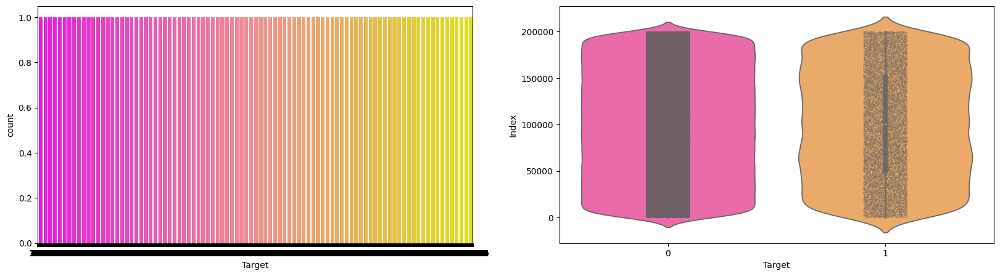

AttributeError: module 'ntpath' has no attribute 'joinsave_dir'

In [10]:
%%time
#Count plot and Violin plot for the target class
fig, ax = plt.subplots(1,2, figsize=(20, 5))
sns.countplot(df_train.target.values, ax= ax[0], palette= "spring")
sns.violinplot(x=df_train.target.values, y= df_train.index.values, ax= ax[1], palette= "spring")
sns.stripplot(x=df_train.target.values, y= df_train.index.values, jitter= True, color= "black", linewidth= 0.5, size= 0.5, alpha= 0.5, ax= ax[1], palette= "spring")
ax[0].set_xlabel("Target")
ax[1].set_xlabel("Target")
ax[1].set_ylabel("Index")
plt.show()
plt.savefig(os.path.join.save_dir, "target_class_count_violin_stripplot.png")

*Observation for the analysis of data and the graphs*

*-We are having unbalanced data , where 90 % of the data is no of customers who will not make a transaction & 10 % of the data are those who will make a transaction.*

*-From the Violin plots, it seems that there is no relationship between the target index of the dataframe, it is more dominated by 0 compared to 1.*

*-From the jitter plots with violin plots, we can observer that target looks uniformly distributed over the indexes of the dataframe.*

**Distribution of Train Attributes**

In [11]:
def plot_train_attribute_distribution(t0, t1, label1, label2, train_attributes):
    sns.set_style("darkgrid")

    n = len(train_attributes)
    cols = 3
    rows = (n + cols - 1) // cols   # proper ceiling division

    fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))
    axes = axes.flatten()

    for i, attribute in enumerate(train_attributes):
        sns.histplot(
            t0[attribute],
            bins=40,
            stat="density",
            kde=True,
            alpha=0.4,
            ax=axes[i],
            label=label1
        )
        sns.histplot(
            t1[attribute],
            bins=40,
            stat="density",
            kde=True,
            alpha=0.4,
            ax=axes[i],
            label=label2
        )
        axes[i].set_title(attribute)
        axes[i].legend()

    # 🔥 REMOVE unused axes
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

*Histplot is used instead of distplot as it is the modern, supported alternative and is more efficient for large datasets when plotting multiple subplots.*


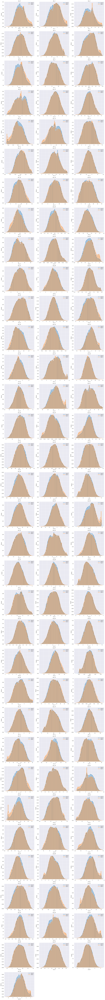

AttributeError: module 'ntpath' has no attribute 'joinsave_dir'

In [15]:
%%time
#Corresponding to negative class
t0= df_train[df_train.target.values == 0]

#Corresponding to positive class
t1= df_train[df_train.target.values == 1]

#train attributes from 2 to 102
train_attributes= df_train.columns.values[2:102]

plot_train_attribute_distribution(
    t0.sample(20000),
    t1.sample(20000),
    "Target 0",
    "Target 1",
    train_attributes
)
plt.savefig(os.path.joinsave_dir, "train_attribute_distribution_2-102.png")

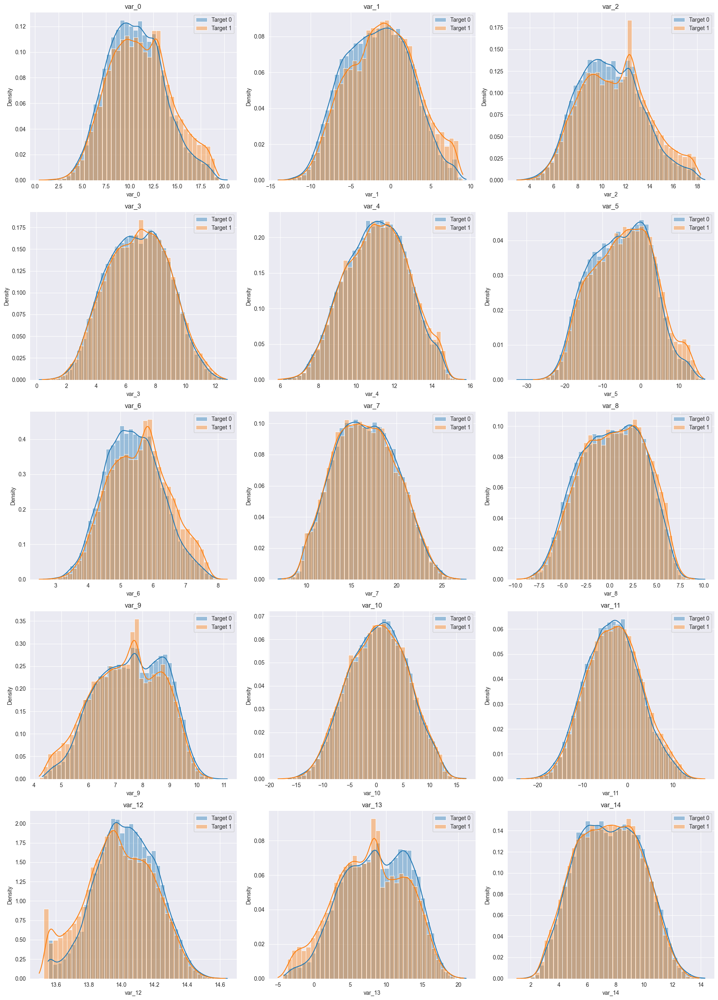

In [24]:
plot_train_attribute_distribution(
    t0.sample(20000),
    t1.sample(20000),
    "Target 0",
    "Target 1",
    train_attributes[:15]
)

**Observing first 100 train attributes from 2 to 102**

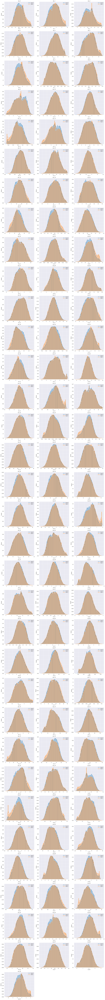

AttributeError: 'function' object has no attribute 'save_dir'

In [25]:
%%time
#Corresponding to negative class
t0= df_train[df_train.target.values == 0]

#Corresponding to positive class
t1= df_train[df_train.target.values == 1]

#train attributes from 2 to 102
train_attributes= df_train.columns.values[2:102]

plot_train_attribute_distribution(
    t0.sample(20000),
    t1.sample(20000),
    "Target 0",
    "Target 1",
    train_attributes
)
plt.savefig(os.path.join.save_dir, "train_attribute_distribution_2-102.png")

**Observing the next 100 train attributes from 102 to 202**

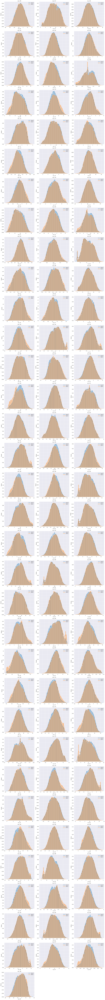

AttributeError: 'function' object has no attribute 'save_dir'

In [26]:
%%time
#train attributes from 102 to 202
train_attributes= df_train.columns.values[102:202]

plot_train_attribute_distribution(
    t0.sample(20000),
    t1.sample(20000),
    "Target 0",
    "Target 1",
    train_attributes
)
plt.savefig(os.path.join.save_dir, "train_attribute_distribution_102-202.png")

*Observation-Train Attribute Distribution* 

*We can observe there is a considerable number of features which have significantly different distribution. For eg, var_0, var_2, var_5, var_6, var_9, var_12 and var_13 etc. There are considerable number of features which depict the features having similar and consistent distribution of a bell shape, for eg. var_65, var_185, var_31, var_124 etc.*

In [24]:
#Importing the test dataset
df_test= pd.read_csv("test.csv")

In [25]:
df_test.head()

,ID_code,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,test_0,11.0656,7.7798,12.9536,9.4292,11.4327,-2.3805,5.8493,18.2675,2.1337,8.8100,-2.0248,-4.3554,13.9696,0.3458,7.5408,14.5001,7.7028,-19.0919,15.5806,16.1763,3.7088,18.8064,1.5899,3.0654,6.4509,14.1192,-9.4902,-2.1917,5.7107,3.7864,-1.7981,9.2645,2.0657,12.7753,11.3334,8.1462,-0.0610,3.5331,9.7804,8.7625,-15.6305,18.8766,11.2864,11.8362,13.3680,-31.9891,12.1776,8.7714,17.2011,16.8508,13.0534,14.4069,-4.8525,7.3213,-0.5259,16.6365,19.3036,6.4129,-5.3948,9.3269,11.9314,-3.5750,-0.7706,0.8705,6.9282,2.8914,5.9744,17.4851,5.0125,-1.4230,33.3401,0.8018,-4.7906,30.2708,26.8339,21.7205,7.3075,14.0810,3.1192,17.4265,9.4883,16.9060,14.5117,10.0276,-0.9706,20.4588,4.7945,20.4160,13.1633,7.9307,-7.6509,7.0834,15.2324,10.1416,5.9156,-0.5775,5.7600,30.3238,2.1251,1.8585,-9.2198,17.3089,30.9548,1.4918,12.8721,3.4902,8.2856,11.9794,14.0176,15.0763,3.7662,6.0426,4.4243,14.1799,2.0921,1.5493,3.2206,0.0172,-6.6602,8.4785,42.0248,11.4164,0.4564,9.4006,0.9685,12.4929,14.1240,4.0388,-4.4442,16.6684,12.5380,0.9205,10.5998,7.5147,-4.1748,-0.4824,10.5267,17.7547,-6.5226,-2.5502,-5.1547,-2.1246,19.8319,13.0752,9.2275,3.0213,11.6793,-11.6827,4.1017,5.2954,18.7741,9.8892,7.5219,14.9745,18.9880,1.0842,11.9125,-4.5103,16.1361,11.0067,5.9232,5.4113,3.8302,5.7380,-8.6105,22.9530,2.5531,-0.2836,4.3416,5.1855,4.2603,1.6779,29.0849,8.4685,18.1317,12.2818,-0.6912,10.2226,-5.5579,2.2926,-4.5358,10.3903,-15.4937,3.9697,31.3521,-1.1651,9.2874,-23.5705,13.2643,1.6591,-2.1556,11.8495,-1.4300,2.4508,13.7112,2.4669,4.3654,10.7200,15.4722,-8.7197
1,test_1,8.5304,1.2543,11.3047,5.1858,9.1974,-4.0117,6.0196,18.6316,-4.4131,5.9739,-1.3809,-0.3310,14.1129,2.5667,5.4988,14.1853,7.0196,4.6564,29.1609,0.0910,12.1469,3.1389,5.2578,2.4228,16.2064,13.5023,-5.2341,-3.6648,5.7080,2.9965,-10.4720,11.4938,-0.9660,15.3445,10.6361,0.8966,6.7428,2.3421,12.8678,-1.5536,10.0309,3.1337,10.5742,11.7664,2.1782,-41.1924,13.5322,-17.3834,6.3806,12.5589,11.6887,25.3930,1.5776,6.8481,8.7348,16.4239,21.7056,6.9345,1.6678,9.5249,5.3383,-18.7083,1.3382,-1.7401,5.8398,3.1051,4.4307,16.0005,5.0306,-7.3365,12.2806,0.6992,-0.7772,21.5123,6.7803,18.1896,6.9388,22.1336,6.3755,13.1525,1.9772,14.0406,6.6904,9.9732,-11.5679,20.4525,9.4951,9.6343,8.1252,2.6059,-17.4201,7.1848,15.3484,10.6522,5.9897,0.3392,10.3516,29.8204,1.9998,-1.4166,-1.7257,15.4712,35.6020,1.6570,13.0783,2.7752,6.4986,4.6835,13.7963,17.7261,1.7375,5.5689,3.6609,8.9725,4.1159,1.0693,2.0234,8.2760,-6.8610,0.2780,17.0488,11.6704,3.1215,8.5093,5.6367,12.0099,14.2372,-

In [26]:
#Shape of the test dataset
df_test.shape

(200000, 201)

In [30]:
%%time
def plot_test_attribute_distribution(test_attributes):
    sns.set_style("darkgrid")

    cols = 3
    rows = (len(test_attributes) + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))
    axes = axes.flatten()

    for i, attribute in enumerate(test_attributes):
        sns.histplot(
            df_test[attribute],
            bins=40,
            stat="density",
            kde=True,
            alpha=0.4,
            ax=axes[i]
        )
        axes[i].set_title(attribute)

    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

CPU times: total: 0 ns
Wall time: 0 ns


**Observing the first 100 test attribute form 1 to 101**

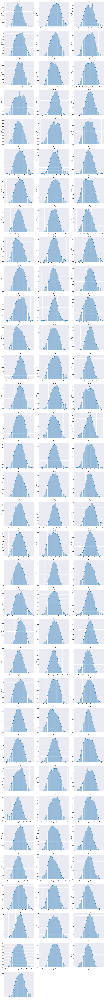

AttributeError: 'function' object has no attribute 'save_dir'

In [31]:
%%time
#test attribute for the first 100 elements from column 1 to 101
test_attributes = df_test.columns.values[1:101]
#plooting the distribution for the test attributes
plot_test_attribute_distribution(
    test_attributes
)
plt.savefig(os.path.join.save_dir, "test_attribute_distribution_1-101.png")

**Observing the next 100 test attributes from 101 to 202**

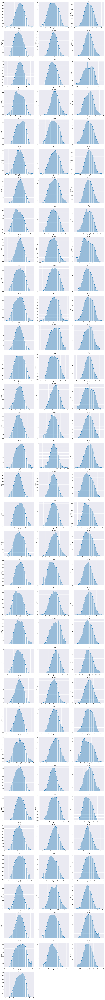

AttributeError: 'function' object has no attribute 'save_dir'

In [32]:
%%time
#test attribute for the first 100 elements from column 101 to 202
test_attributes = df_test.columns.values[101:202]
#plooting the distribution for the test attributes
plot_test_attribute_distribution(
    test_attributes
)
plt.savefig(os.path.join.save_dir, "test_attribute_distribution_102-202.png")

*Observation – Test Attributes Distribution*

*We can observe that a few test features show significantly different distributions, such as var_2, var_5, var_9, var_12, and var_13. There are also a considerable number of features that exhibit similar and consistent bell-shaped distributions, for example var_0, var_6, var_31, var_65, var_124, and many others.*

**Distribution of Mean Values per rows and columns.**

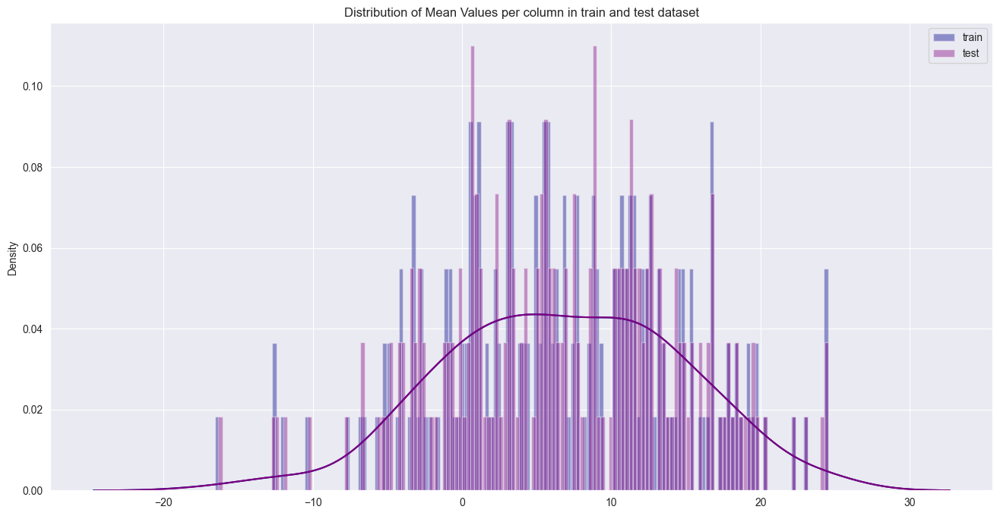

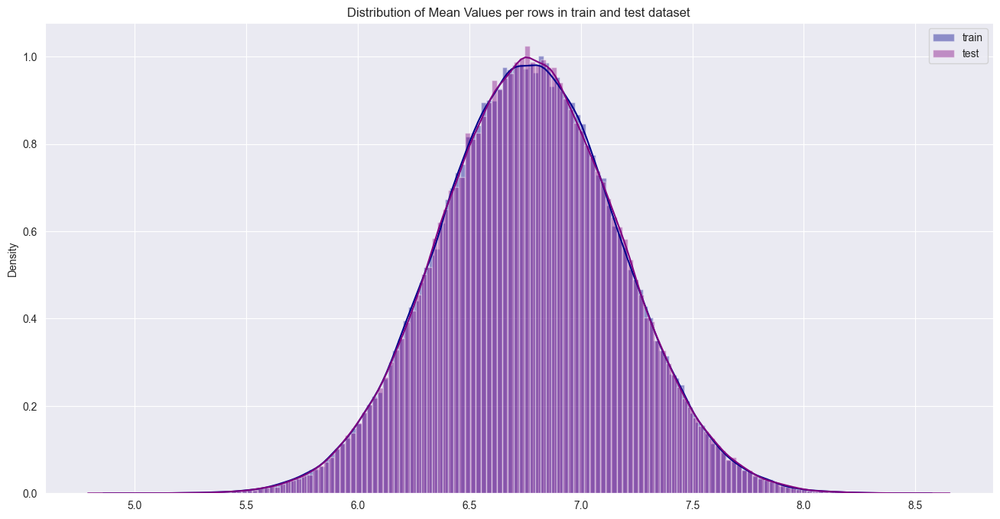

CPU times: total: 4.66 s
Wall time: 4.67 s


In [33]:
%%time
#Distribution of Mean Values per column in train and test dataset
plt.figure(figsize=(16, 8))

#Train attributes-
train_attributes= df_train.columns.values[2:202]

#Test attributes-
test_attributes= df_test.columns.values[1:201]

#Distributionplot for mean values per column in train attributes
sns.distplot(df_train[train_attributes].mean(axis= 0), color= "darkblue", kde=True, bins=150, label= "train")

#Distributionplot for mean values per column in test attributes
sns.distplot(df_test[test_attributes].mean(axis= 0), color= "purple", kde=True, bins=150, label= "test")

plt.title("Distribution of Mean Values per column in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "mean_value_distribution_colums.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

#Distribution of Mean Values per row in train and test dataset
plt.figure(figsize=(16, 8))

#Distributionplot for mean values per row in train attributes
sns.distplot(df_train[train_attributes].mean(axis= 1), color= "darkblue", kde=True, bins=150, label= "train")

#Distributionplot for mean values per row in test attributes
sns.distplot(df_test[test_attributes].mean(axis= 1), color= "purple", kde=True, bins=150, label= "test")

plt.title("Distribution of Mean Values per rows in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "mean_value_distribution_rows.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

**Distribution of Standard Deviation Values per rows and columns**

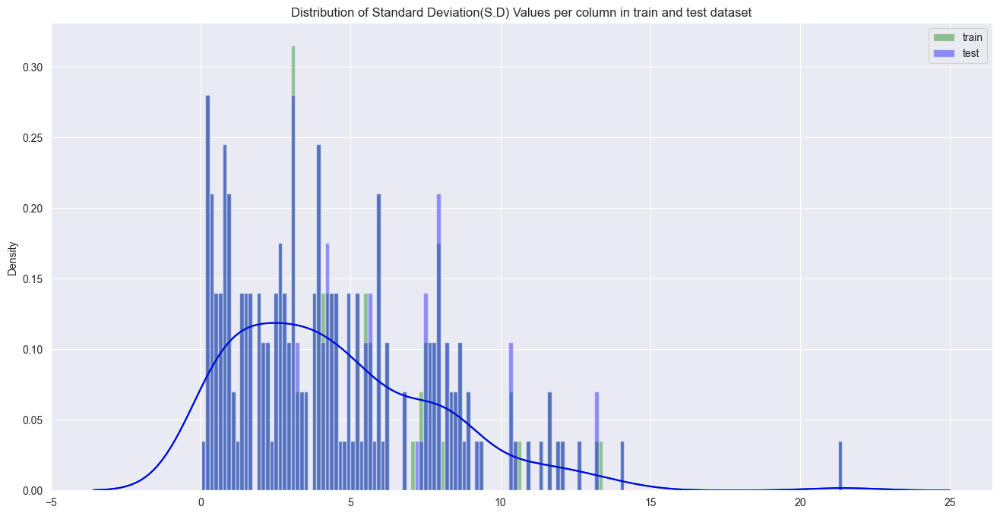

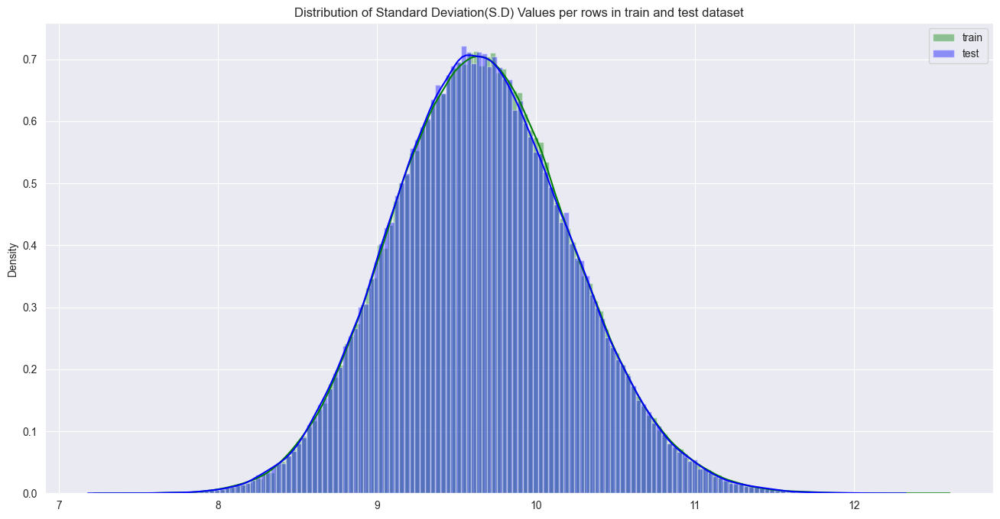

CPU times: total: 6 s
Wall time: 6.05 s


In [34]:
%%time
#Distribution of standard deviation values per columns in train and test dataset
plt.figure(figsize=(16,8))

#Train attributes-
train_attributes= df_train.columns.values[2:202]

#Test attributes-
test_attributes= df_test.columns.values[1:201]

#Distributionplot for standard deviation values per column in train attributes
sns.distplot(df_train[train_attributes].std(axis= 0), color= "green", kde=True, bins=150, label= "train")

#Distributionplot for standard deviation values per column in test attributes
sns.distplot(df_test[test_attributes].std(axis= 0), color= "blue", kde=True, bins=150, label= "test")

plt.title("Distribution of Standard Deviation(S.D) Values per column in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "S.D_value_distribution_colums.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

#Distribution of Standard Deviation values per row in train and test dataset
plt.figure(figsize=(16, 8))

#Distributionplot for standard deviation values per row in train attributes
sns.distplot(df_train[train_attributes].std(axis= 1), color= "green", kde=True, bins=150, label= "train")

#Distributionplot for standard deviation values per row in test attributes
sns.distplot(df_test[test_attributes].std(axis= 1), color= "blue", kde=True, bins=150, label= "test")

plt.title("Distribution of Standard Deviation(S.D) Values per rows in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "S.D_value_distribution_rows.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

**Distribution of Kurtosis Values per rows and columns**

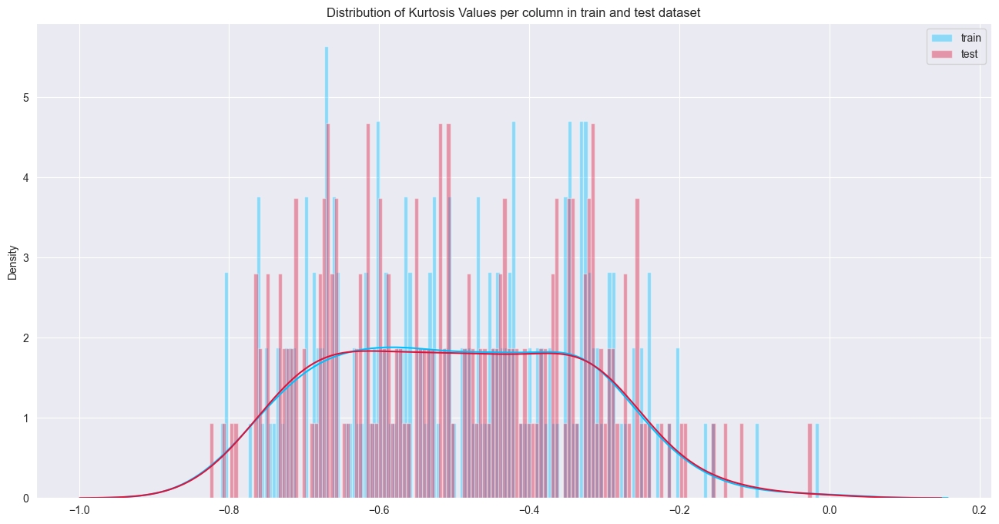

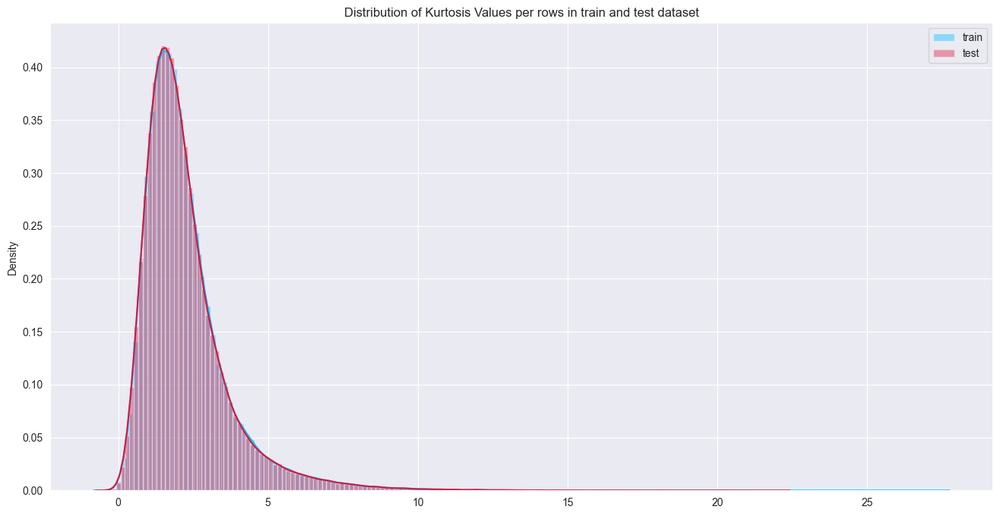

CPU times: total: 5.16 s
Wall time: 5.18 s


In [35]:
%%time
#Distribution of standard deviation values per columns in train and test dataset
plt.figure(figsize=(16,8))

#Train attributes-
train_attributes= df_train.columns.values[2:202]

#Test attributes-
test_attributes= df_test.columns.values[1:201]

#Distributionplot for Kutosis values per column in train attributes
sns.distplot(df_train[train_attributes].kurtosis(axis= 0), color= "deepskyblue", kde=True, bins=150, label= "train")

#Distributionplot for Kurtosis values per column in test attributes
sns.distplot(df_test[test_attributes].kurtosis(axis= 0), color= "crimson", kde=True, bins=150, label= "test")

plt.title("Distribution of Kurtosis Values per column in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "kurtosis_value_distribution_colums.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

#Distribution of Kurtosis per row in train and test dataset
plt.figure(figsize=(16, 8))

#Distributionplot for Kurtosis values per row in train attributes
sns.distplot(df_train[train_attributes].kurtosis(axis= 1), color= "deepskyblue", kde=True, bins=150, label= "train")

#Distributionplot for kurtosis values per row in test attributes
sns.distplot(df_test[test_attributes].kurtosis(axis= 1), color= "crimson", kde=True, bins=150, label= "test")

plt.title("Distribution of Kurtosis Values per rows in train and test dataset")
plt.savefig(
    os.path.join(save_dir1, "kutosis_value_distribution_rows.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.legend()
plt.show()

**Missing Value Analysis**

In [36]:
%%time
#Find the missing values in train and test dataset
train_missing= df_train.isnull().sum().sum()
test_missing= df_test.isnull().sum().sum()

print("Missing values in the train dataset:", train_missing)
print("Missing values in the test dataset:", test_missing)

Missing values in the train dataset: 0
Missing values in the test dataset: 0
CPU times: total: 109 ms
Wall time: 101 ms


*Observation-No missing values are present in the train and the test datasets*

In [37]:
%%time
#Correlation for the train attributes
train_attributes = df_train.columns.values[2:202]
train_correlation = df_train[train_attributes].corr().abs().unstack().sort_values(kind="quicksort").reset_index()
train_correlation = train_correlation[train_correlation["level_0"] != train_correlation["level_1"]]
print(train_correlation.head(10))
print(train_correlation.tail(10))

   level_0  level_1             0
0   var_75  var_191  2.703975e-08
1  var_191   var_75  2.703975e-08
2  var_173    var_6  5.942735e-08
3    var_6  var_173  5.942735e-08
4  var_126  var_109  1.313947e-07
5  var_109  var_126  1.313947e-07
6  var_144   var_27  1.772502e-07
7   var_27  var_144  1.772502e-07
8  var_177  var_100  3.116544e-07
9  var_100  var_177  3.116544e-07
       level_0  level_1         0
39790  var_183  var_189  0.009359
39791  var_189  var_183  0.009359
39792  var_174   var_81  0.009490
39793   var_81  var_174  0.009490
39794   var_81  var_165  0.009714
39795  var_165   var_81  0.009714
39796   var_53  var_148  0.009788
39797  var_148   var_53  0.009788
39798   var_26  var_139  0.009844
39799  var_139   var_26  0.009844
CPU times: total: 10.4 s
Wall time: 10.5 s


*Observation-correlation amongst the train attributes is very small*

In [38]:
%%time
#Correlation for  the test attributes
test_attributes = df_test.columns.values[1:201]
test_correlation = df_test[test_attributes].corr().abs().unstack().sort_values(kind="quicksort").reset_index()
test_correlation = test_correlation[test_correlation["level_0"] != test_correlation["level_1"]]
print(test_correlation.head(10))
print(test_correlation.tail(10))

   level_0  level_1             0
0  var_154  var_175  1.477268e-07
1  var_175  var_154  1.477268e-07
2  var_188  var_113  1.639749e-07
3  var_113  var_188  1.639749e-07
4  var_131    var_8  4.695407e-07
5    var_8  var_131  4.695407e-07
6   var_60  var_189  9.523709e-07
7  var_189   var_60  9.523709e-07
8  var_159   var_96  1.147835e-06
9   var_96  var_159  1.147835e-06
       level_0  level_1         0
39790  var_122  var_164  0.008513
39791  var_164  var_122  0.008513
39792  var_164    var_2  0.008614
39793    var_2  var_164  0.008614
39794   var_31  var_132  0.008714
39795  var_132   var_31  0.008714
39796   var_96  var_143  0.008829
39797  var_143   var_96  0.008829
39798  var_139   var_75  0.009868
39799   var_75  var_139  0.009868
CPU times: total: 10.4 s
Wall time: 10.4 s


*Observation-correlation amongst the test attributes is very small*

**Correlation plot between the train and test dataset**

In [39]:
print(df_train[train_attributes].corr().isna().sum().sum())
print(df_test[test_attributes].corr().isna().sum().sum())

0
0


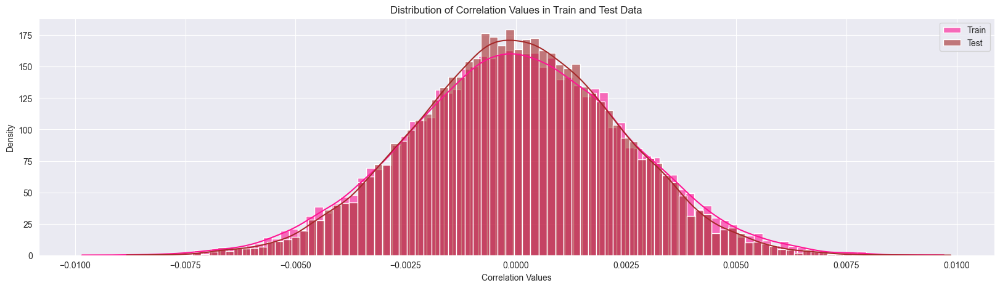

In [40]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
# =========================
# Feature lists
# =========================
train_attributes = df_train.columns.values[2:202]
test_attributes  = df_test.columns.values[1:201]
# =========================
# Train correlations
# =========================
train_corr = df_train[train_attributes].corr()
# Keep only upper triangle (exclude diagonal)
train_correlation = (
    train_corr
    .where(np.triu(np.ones(train_corr.shape), k=1).astype(bool))
    .stack()
    .values
)
# =========================
# Test correlations
# =========================
test_corr = df_test[test_attributes].corr()
test_correlation = (
    test_corr
    .where(np.triu(np.ones(test_corr.shape), k=1).astype(bool))
    .stack()
    .values
)
# =========================
# Plot
# =========================
plt.figure(figsize=(20, 5))
sns.histplot(
    train_correlation,
    bins=100,
    kde=True,
    stat="density",
    color="deeppink",
    label="Train",
    alpha=0.6
)
sns.histplot(
    test_correlation,
    bins=100,
    kde=True,
    stat="density",
    color="brown",
    label="Test",
    alpha=0.6
)
plt.xlabel("Correlation Values")
plt.ylabel("Density")
plt.title("Distribution of Correlation Values in Train and Test Data")
plt.legend()
plt.savefig(
    os.path.join(save_dir, "correlation_btw_train_test_data.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.show()

*Correaltion values found in the train and test data is very small, and this is completely visible as we can see in the graph.*

**Feature Engineering**

*Performing feature engineering using -Permutation Importance and Partial Dependence plots.*

In [41]:
df_train

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,5.7470,2.9252,3.1821,14.0137,0.5745,8.7989,14.5691,5.7487,-7.2393,4.2840,30.7133,10.5350,16.2191,2.5791,2.4716,14.3831,13.4325,-5.1488,-0.4073,4.9306,5.9965,-0.3085,12.9041,-3.8766,16.8911,11.1920,10.5785,0.6764,7.8871,4.6667,3.8743,-5.2387,7.3746,11.5767,12.0446,11.6418,-7.0170,5.9226,-14.2136,16.0283,5.3253,12.9194,29.0460,-0.6940,5.1736,-0.7474,14.8322,11.2668,5.3822,2.0183,10.1166,16.1828,4.9590,2.0771,-0.2154,8.6748,9.5319,5.8056,22.4321,5.0109,-4.7010,21.6374,0.5663,5.1999,8.8600,43.1127,18.3816,-2.3440,23.4104,6.5199,12.1983,13.6468,13.8372,1.3675,2.9423,-4.5213,21.4669,9.3225,16.4597,7.9984,-1.7069,-21.4494,6.7806,11.0924,9.9913,14.8421,0.1812,8.9642,16.2572,2.1743,-3.4132,9.4763,13.3102,26.5376,1.4403,14.7100,6.0454,9.5426,17.1554,14.1104,24.3627,2.0323,6.7602,3.9141,-0.4851,2.5240,1.5093,2.5516,15.5752,-13.4221,7.2739,16.0094,9.7268,0.8897,0.7754,4.2218,12.0039,13.8571,-0.7338,-1.9245,15.4462,12.8287,0.3587,9.6508,6.5674,5.1726,3.1345,29.4547,31.4045,2.8279,15.6599,8.3307,-5.6011,19.0614,11.2663,8.6989,8.3694,11.5659,-16.4727,4.0288,17.9244,18.5177,10.7800,9.0056,16.6964,10.4838,1.6573,12.1749,-13.1324,17.6054,11.5423,15.4576,5.3133,3.6159,5.0384,6.6760,12.6644,2.7004,-0.6975,9.5981,5.4879,-4.7645,-8.4254,20.8773,3.1531,18.5618,7.7423,-10.1245,13.7241,-3.5189,1.7202,-8.4051,9.0164,3.0657,14.3691,25.8398,5.8764,11.8411,-19.7159,17.5743,0.5857,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,8.0851,-0.4032,8.0585,14.0239,8.4135,5.4345,13.7003,13.8275,-15.5849,7.8000,28.5708,3.4287,2.7407,8.5524,3.3716,6.9779,13.8910,-11.7684,-2.5586,5.0464,0.5481,-9.2987,7.8755,1.2859,19.3710,11.3702,0.7399,2.7995,5.8434,10.8160,3.6783,-11.1147,1.8730,9.8775,11.7842,1.2444,-47.3797,7.3718,0.1948,34.4014,25.7037,11.8343,13.2256,-4.1083,6.6885,-8.0946,18.5995,19.3219,7.0118,1.9210,8.8682,8.0109,-7.2417,1.7944,-1.3147,8.1042,1.5365,5.4007,7.9344,5.0220,2.2302,40.5632,0.5134,3.1701,20.1068,7.7841,7.0529,3.2709,23.4822,5.5075,13.7814,2.5462,18.1782,0.3683,-4.8210,-5.4850,13.7867,-13.5901,11.0993,7.9022,12.2301,0.4768,6.8852,8.0905,10.9631,11.7569,-1.2722,24.7876,26.6881,1.8944,0.6939,-13.6950,8.4068,35.4734,1.7093,15.1866,2.6227,7.3412,32.0888,13.9550,13.0858,6.6203,7.1051,5.3523,8.5426,3.6159,4.1569,3.0454,7.8522,-11.5100,7.5109,31.5899,9.5018,8.2736,10.1633,0.1225,12.5942,14.5697

In [27]:
df_test

,ID_code,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,test_0,11.0656,7.7798,12.9536,9.4292,11.4327,-2.3805,5.8493,18.2675,2.1337,8.8100,-2.0248,-4.3554,13.9696,0.3458,7.5408,14.5001,7.7028,-19.0919,15.5806,16.1763,3.7088,18.8064,1.5899,3.0654,6.4509,14.1192,-9.4902,-2.1917,5.7107,3.7864,-1.7981,9.2645,2.0657,12.7753,11.3334,8.1462,-0.0610,3.5331,9.7804,8.7625,-15.6305,18.8766,11.2864,11.8362,13.3680,-31.9891,12.1776,8.7714,17.2011,16.8508,13.0534,14.4069,-4.8525,7.3213,-0.5259,16.6365,19.3036,6.4129,-5.3948,9.3269,11.9314,-3.5750,-0.7706,0.8705,6.9282,2.8914,5.9744,17.4851,5.0125,-1.4230,33.3401,0.8018,-4.7906,30.2708,26.8339,21.7205,7.3075,14.0810,3.1192,17.4265,9.4883,16.9060,14.5117,10.0276,-0.9706,20.4588,4.7945,20.4160,13.1633,7.9307,-7.6509,7.0834,15.2324,10.1416,5.9156,-0.5775,5.7600,30.3238,2.1251,1.8585,-9.2198,17.3089,30.9548,1.4918,12.8721,3.4902,8.2856,11.9794,14.0176,15.0763,3.7662,6.0426,4.4243,14.1799,2.0921,1.5493,3.2206,0.0172,-6.6602,8.4785,42.0248,11.4164,0.4564,9.4006,0.9685,12.4929,14.1240,4.0388,-4.4442,16.6684,12.5380,0.9205,10.5998,7.5147,-4.1748,-0.4824,10.5267,17.7547,-6.5226,-2.5502,-5.1547,-2.1246,19.8319,13.0752,9.2275,3.0213,11.6793,-11.6827,4.1017,5.2954,18.7741,9.8892,7.5219,14.9745,18.9880,1.0842,11.9125,-4.5103,16.1361,11.0067,5.9232,5.4113,3.8302,5.7380,-8.6105,22.9530,2.5531,-0.2836,4.3416,5.1855,4.2603,1.6779,29.0849,8.4685,18.1317,12.2818,-0.6912,10.2226,-5.5579,2.2926,-4.5358,10.3903,-15.4937,3.9697,31.3521,-1.1651,9.2874,-23.5705,13.2643,1.6591,-2.1556,11.8495,-1.4300,2.4508,13.7112,2.4669,4.3654,10.7200,15.4722,-8.7197
1,test_1,8.5304,1.2543,11.3047,5.1858,9.1974,-4.0117,6.0196,18.6316,-4.4131,5.9739,-1.3809,-0.3310,14.1129,2.5667,5.4988,14.1853,7.0196,4.6564,29.1609,0.0910,12.1469,3.1389,5.2578,2.4228,16.2064,13.5023,-5.2341,-3.6648,5.7080,2.9965,-10.4720,11.4938,-0.9660,15.3445,10.6361,0.8966,6.7428,2.3421,12.8678,-1.5536,10.0309,3.1337,10.5742,11.7664,2.1782,-41.1924,13.5322,-17.3834,6.3806,12.5589,11.6887,25.3930,1.5776,6.8481,8.7348,16.4239,21.7056,6.9345,1.6678,9.5249,5.3383,-18.7083,1.3382,-1.7401,5.8398,3.1051,4.4307,16.0005,5.0306,-7.3365,12.2806,0.6992,-0.7772,21.5123,6.7803,18.1896,6.9388,22.1336,6.3755,13.1525,1.9772,14.0406,6.6904,9.9732,-11.5679,20.4525,9.4951,9.6343,8.1252,2.6059,-17.4201,7.1848,15.3484,10.6522,5.9897,0.3392,10.3516,29.8204,1.9998,-1.4166,-1.7257,15.4712,35.6020,1.6570,13.0783,2.7752,6.4986,4.6835,13.7963,17.7261,1.7375,5.5689,3.6609,8.9725,4.1159,1.0693,2.0234,8.2760,-6.8610,0.2780,17.0488,11.6704,3.1215,8.5093,5.6367,12.0099,14.2372,-

In [43]:
#Training and Testing data
X= df_train.drop(columns= ["ID_code", "target"], axis= 1)
test= df_test.drop(columns= ["ID_code"], axis= 1)   
y= df_train["target"]

*Build a simple model to find the features which are more important.*

In [44]:
#Split the train data
X_train, X_test, y_train, y_test= train_test_split(X, y, random_state= 42)

*Random Forest Classifier*

In [45]:
%%time
rf_model= RandomForestClassifier(n_estimators= 10, random_state= 42)

#Fitting the model
rf_model.fit(X_test, y_test)

CPU times: total: 28.6 s
Wall time: 28.8 s


,n_estimators,10
,criterion,'gini'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,'sqrt'
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


*Calculating Weights and Observing important features using the eli5 Library. Eli5 is a Python package which helps us to debug machine learning clasifiers and explain their predictions.*

In [46]:
%%time
#Permutation Importance:-
from eli5.sklearn import PermutationImportance
perm_imp= PermutationImportance(rf_model, random_state= 42)

#fitting the model
perm_imp.fit(X_train, y_train)

CPU times: total: 4min 54s
Wall time: 4min 54s


,estimator,RandomForestC...ndom_state=42)
,scoring,None
,n_iter,5
,random_state,42
,cv,'prefit'
,refit,True
,n_estimators,10
,criterion,'gini'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1


In [47]:
#Important Features
eli5.show_weights(perm_imp, feature_names= X_test.columns.tolist(), top= 200)

Weight,Feature
0.0001 ± 0.0001,var_78
0.0001 ± 0.0000,var_170
0.0001 ± 0.0000,var_52
0.0001 ± 0.0001,var_12
0.0001 ± 0.0001,var_174
0.0001 ± 0.0001,var_81
0.0001 ± 0.0000,var_167
0.0001 ± 0.0000,var_186
0.0001 ± 0.0001,var_184
0.0001 ± 0.0001,var_6


*Observation- Features having highest to lowest importance is in decreasing order as shown in the prediction.* 

*Features that are shown/displayed in green colour have higher positve impact on prediction and features havong zero impact have no colour.*

**Partial Dependence Plots**

*PDP gives a graphical depiction of marginal effect of a variable on a class probability or classification.It shows how a feature effects predictions.*

In [48]:
from sklearn.ensemble import RandomForestClassifier
rf_model = RandomForestClassifier(
    n_estimators=10,
    random_state=42,
    n_jobs=-1
)
rf_model.fit(X_train, y_train)

,n_estimators,10
,criterion,'gini'
,max_depth,None
,min_samples_split,2
,min_samples_leaf,1
,min_weight_fraction_leaf,0.0
,max_features,'sqrt'
,max_leaf_nodes,None
,min_impurity_decrease,0.0
,bootstrap,True
,oob_score,False


In [65]:
features= [v for v in X_test.columns if v not in ["ID_code", "target"]]

In [75]:
from pdpbox import pdp

pdp_data = pdp.pdp_isolate(
    rf_model,
    X_train[features],   # TRAIN DATA ONLY
    "var_6",             # FEATURE NAME
    10                   # num_grid_points (INT)
)

In [77]:
print(pdp_data)

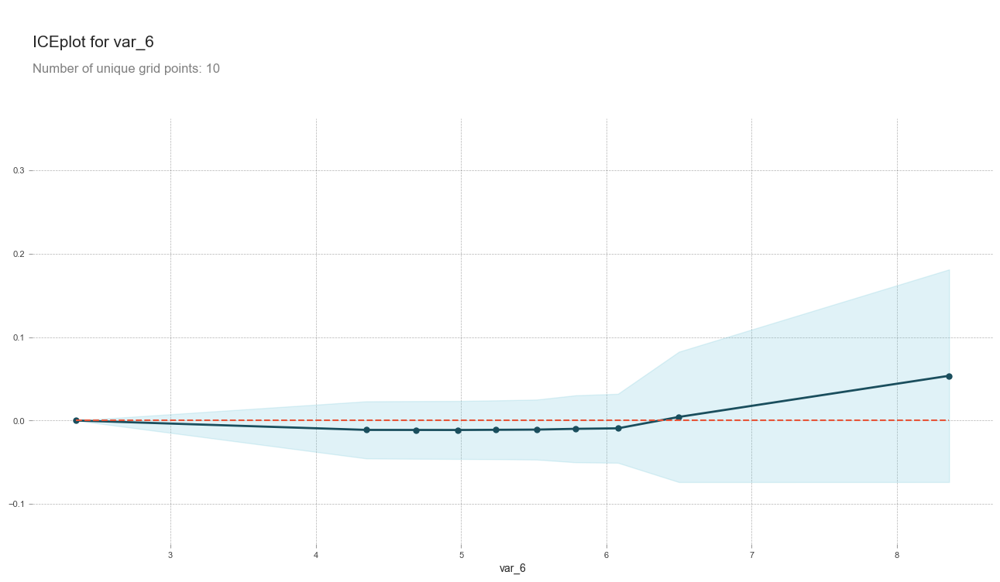

In [78]:
pdp.pdp_plot(pdp_data, "var_6")
plt.savefig(
    os.path.join(save_dir, "pdp_var_6_random_forest.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.show()

*Observation-The y-axis shows how the value changes with the change in the value of the predictor variable. The blue shaded area indicates level of confidence of var_6. On y-axis having a positive value means for that particular value it is less likely to predict the correct class and having a positive value means it has a positive impact on predicting the correct class.*

In [82]:
from pdpbox import pdp
pdp_data = pdp.pdp_isolate(
    rf_model,
    X_train[features],   # TRAIN DATA ONLY
    "var_53",             # FEATURE NAME
    10                   # num_grid_points (INT)
)

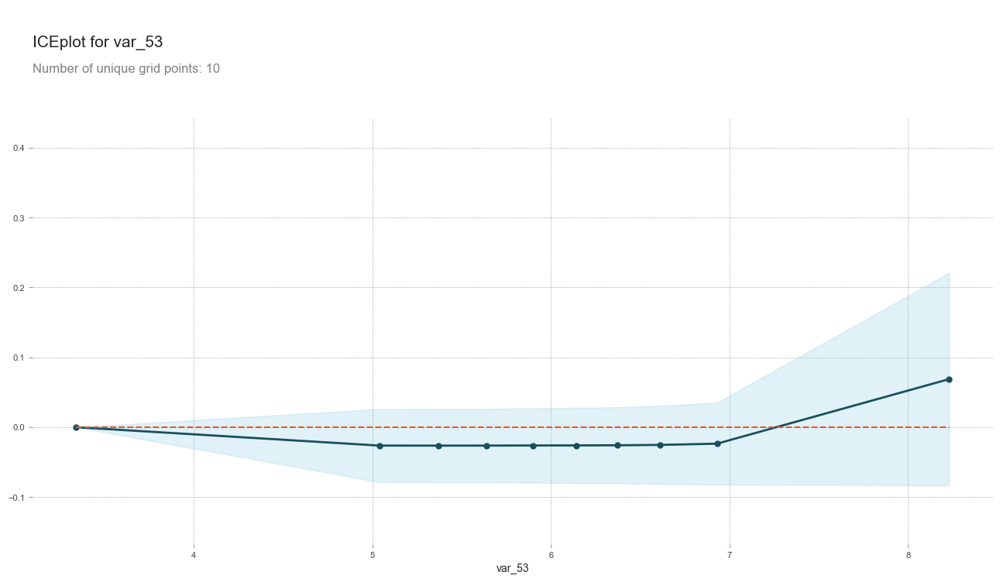

In [83]:
pdp.pdp_plot(pdp_data, "var_53")
plt.savefig(
    os.path.join(save_dir, "pdp_var_53_random_forest.png"),
    dpi=300,
    bbox_inches="tight"
)
plt.show()

*Observation-The y-axis shows how the value changes with the change in the value of the predictor variable. The blue shaded area indicates level of confidence of var_53. On y-axis having a positive value means for that particular value it is less likely to predict the correct class and having a positive value means it has a positive impact on predicting the correct class.*

**Handling of Imbalanced Data**

*Multiple approaches can be used for dealing with the imbalanced datasets.*

*1.Change of performance matrix*,

*2.Oversample minority class*,

*3.Undersample majority class*

*4.SMOTE(Synthetic minority Oversampling Technique)*,

*5.Change of algorithm*.

**Logistic Regression Model**

In [10]:
#Splitting the data with Stratified K Fold Cross Validation
#Training data
X= df_train.drop(["ID_code", "target"], axis= 1)
Y= df_train["target"]

#Stratified KFold Cross Validatior:-
skf= StratifiedKFold(n_splits= 5, random_state= 42, shuffle= True)
for train_index, valid_index in skf.split(X, Y):
    X_train, X_valid= X.iloc[train_index], X.iloc[valid_index]
    y_train, y_valid= Y.iloc[train_index], Y.iloc[valid_index]

print("Shape of X_train:", X_train.shape)
print("Shape of X_valid:", X_valid.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_valid:", y_valid.shape)

Shape of X_train: (160000, 200)
Shape of X_valid: (40000, 200)
Shape of y_train: (160000,)
Shape of y_valid: (40000,)


In [11]:
%%time
#logistic regression model
lr_model= LogisticRegression(random_state= 42)
#fitting the model
lr_model.fit(X_train, y_train)

CPU times: total: 26.8 s
Wall time: 3.25 s


,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,100
,multi_class,'deprecated'


In [12]:
#Accuracy of the model
lr_score= lr_model.score(X_train, y_train)
print("Accuracy of the lr_model:", lr_score)

Accuracy of the lr_model: 0.9122


In [13]:
%%time
#Cross validation prediction of lr_model-
cv_predict= cross_val_predict(lr_model, X_valid, y_valid, cv= 5)
#Cross Validation score
cv_score= cross_val_score(lr_model, X_valid, y_valid, cv= 5)
print("corss val score:", np.average(cv_score))

corss val score: 0.9106249999999999
CPU times: total: 36.2 s
Wall time: 6.02 s


In [15]:
unique, counts= np.unique(cv_predict, return_counts= True)
dict(zip(unique, counts))

{0: 38559, 1: 1441}

In [16]:
cv_predict

array([1, 0, 0, ..., 0, 0, 0], dtype=int64)

*Accuracy of the model is not the best metrci to use while evaluating the imbalanced datasets as it maybe misleading. We are going to change the performance metric.*

**Confusion Matrix**

In [47]:
#Confusion matrix
cm= confusion_matrix(y_valid, cv_predict)
cm= pd.crosstab(y_valid, cv_predict)

In [48]:
cm

col_0,0,1
target,,
0,35482,498
1,3077,943


In [53]:
#ROC_AUC Score:-
roc_score= roc_auc_score(y_valid, cv_predict)
print("ROC score for lr_model:", roc_score)

ROC score for lr_model: 0.6103680458187108


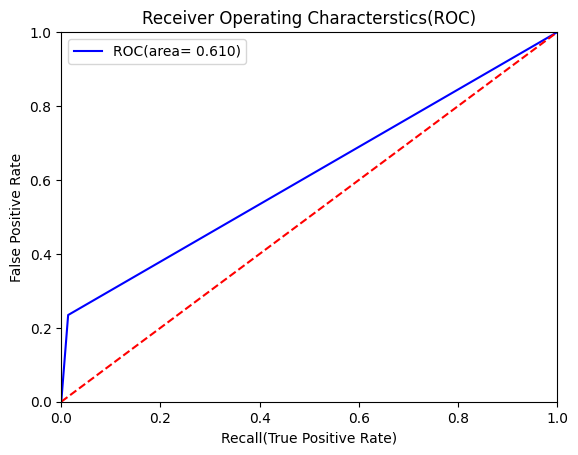

AUC 0.6103680458187108


In [56]:
#ROC AUC curve
plt.figure()
false_positive_rate, recall, thresholds= roc_curve(y_valid, cv_predict)
roc_auc= auc(false_positive_rate, recall)
plt.title("Receiver Operating Characterstics(ROC)")
plt.plot(false_positive_rate, recall, "b", label= "ROC(area= %0.3f)" %roc_auc)
plt.legend()
plt.plot([0, 1], [0, 1], "r--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel("Recall(True Positive Rate)")
plt.ylabel("False Positive Rate")
plt.savefig(
    os.path.join(save_dir, "roc_auc_curve.png")
)
plt.show()
print("AUC", roc_auc)

*Observartion- On comparing the roc_auc_score and model accuracy, model is not performing well on imbalanced data.*

In [21]:
#Classification Report
classification_scores= classification_report(y_valid, cv_predict)
print(classification_scores)

              precision    recall  f1-score   support

           0       0.92      0.99      0.95     35980
           1       0.65      0.23      0.35      4020

    accuracy                           0.91     40000
   macro avg       0.79      0.61      0.65     40000
weighted avg       0.89      0.91      0.89     40000



*Observation- As we can see that F1 score is high for the customers who will not make a transaction, compared to those who will make a transaction. So we are going to change the algorithm.*

In [28]:
%%time
#Model performance on test data:-
X_test= df_test.drop(["ID_code"], axis= 1)
lr_pred= lr_model.predict(X_test)
print(lr_pred)

[0 0 0 ... 0 0 0]
CPU times: total: 188 ms
Wall time: 100 ms


**Type markdown and LateX- a^2**

**Oversample Minority Class**

*- Adding more copies of minority class*

*- It can be a good option we don't have that much large data to work*

*- Drawback of this process is that we are adding information which may lead to overfitting or poor performance on test data.*


**Undersample Minority Class**

*- Removing some copies of majority class*

*- It can be very good option if we have a very large amout of the data, let's say in millions to work*

*- Drawback of this process is we are removing some valuable information, this can lead to underfitting and poor performance on test data.*


*As per the drawbacks of both the model we will use the SMOTE(Synthetic Minority Oversampling Technique) that is more better as compared to the above.*


**SMOTE(Synthetic Minority Oversampling Technique)** - 

*This is a stastical technique for increasing the number of cases in your dataset in a balanced way. It uses the nearest neighbours algorithm to generate new and synthetic data to use for the training model.*

In [33]:
!pip install imbalanced-learn

In [35]:
%%time
from imblearn.over_sampling import SMOTE
#SMOTE:-
sm= SMOTE(random_state= 42, sampling_strategy= 1.0)
#Generating synthetic datapoints
X_smote, y_smote= sm.fit_resample(X_train, y_train)
X_smote_v, y_smote_v= sm.fit_resample(X_valid, y_valid)

CPU times: total: 6.48 s
Wall time: 4.03 s


**Building Logistic Regression Model On Synthetic Data Points**

In [36]:
%%time
#Logistic Regression Model For SMOTE:-
smote= LogisticRegression(random_state= 42)
#fitting the smote model
smote.fit(X_smote, y_smote)

CPU times: total: 46.6 s
Wall time: 5.54 s


,penalty,'l2'
,dual,False
,tol,0.0001
,C,1.0
,fit_intercept,True
,intercept_scaling,1
,class_weight,None
,random_state,42
,solver,'lbfgs'
,max_iter,100
,multi_class,'deprecated'


In [37]:
#Accuracy of the model
smote_score= smote.score(X_smote, y_smote)
print("Accuracy of the smote_model:", smote_score)

Accuracy of the smote_model: 0.7887675268548241


In [39]:
%%time
#Cross validation prediction for smote:-
cv_pred= cross_val_predict(smote, X_smote_v, y_smote_v, cv= 5)
#Cross Validation score:-
cv_score= cross_val_score(smote, X_smote_v, y_smote_v, cv= 5)
print("Cross validation score for the smote_model is:", np.average(cv_score))

Cross validation score for the smote_model is: 0.7965536409116176
CPU times: total: 1min 23s
Wall time: 10.3 s


In [40]:
%%time
#Confusion Matrix
cm= confusion_matrix(y_smote_v, cv_pred)
cm= pd.crosstab(y_smote_v, cv_pred)

CPU times: total: 46.9 ms
Wall time: 21 ms


In [41]:
cm

col_0,0,1
target,,
0,28185,7795
1,6845,29135


In [44]:
#ROC_AUC Score:-
roc_score= roc_auc_score(y_smote_v, cv_pred)
print("ROC score:", roc_score)

ROC score: 0.7965536409116176


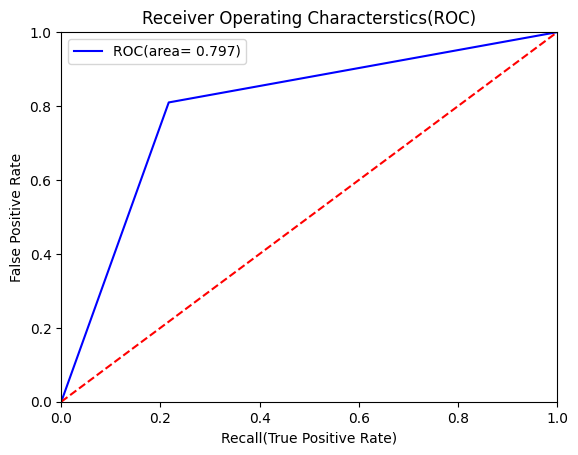

AUC for smote_model: 0.7965536409116176


In [55]:
#ROC AUC curve for smote_model
plt.figure()
false_positive_rate, recall, thresholds= roc_curve(y_smote_v, cv_pred)
roc_auc= auc(false_positive_rate, recall)
plt.title("Receiver Operating Characterstics(ROC)")
plt.plot(false_positive_rate, recall, "b", label= "ROC(area= %0.3f)" %roc_auc)
plt.legend()
plt.plot([0, 1], [0, 1], "r--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel("Recall(True Positive Rate)")
plt.ylabel("False Positive Rate")
plt.savefig(
    os.path.join(save_dir, "roc_auc_curve_smote.png")
)
plt.show()
print("AUC for smote_model:", roc_auc)

In [57]:
#Classification Report
scores= classification_report(y_smote_v, cv_pred)
print(scores)

              precision    recall  f1-score   support

           0       0.80      0.78      0.79     35980
           1       0.79      0.81      0.80     35980

    accuracy                           0.80     71960
   macro avg       0.80      0.80      0.80     71960
weighted avg       0.80      0.80      0.80     71960



*We can observe that the F1 score is high for the customers who didn't make the transaction as well as the customers who made the transaction.*

In [58]:
%%time
#Predicting the model on the test data
X_test= df_test.drop(["ID_code"], axis= 1)
smote_pred= smote.predict(X_test)
print(smote_pred)

[1 1 0 ... 0 0 1]
CPU times: total: 531 ms
Wall time: 406 ms


**LightGBM-** 

*It is a gradient boosting framework that uses tree based learning algorithm.*

In [70]:
lgb_train = lgb.Dataset(
    X_train,
    label=y_train,
    params={"feature_pre_filter": False}
)

lgb_valid = lgb.Dataset(
    X_valid,
    label=y_valid,
    params={"feature_pre_filter": False},
    reference=lgb_train
)

In [71]:
params = {
    "boosting_type": "gbdt",
    "objective": "binary",
    "metric": "auc",

    "learning_rate": 0.01,
    "num_leaves": 50,
    "max_depth": -1, # no limit for max_depth if < 0
    "max_bin": 100, #default 255

    "feature_fraction": 0.08,
    "bagging_fraction": 0.5,
    "bagging_freq": 5,

    "min_split_gain": 0.45,
    "min_child_samples": 5,

    "scale_pos_weight": 9,   # better than is_unbalanced
    "feature_pre_filter": False,  #REQUIRED fix

    "num_threads": 20,
    "seed": 42,
    "verbosity": -1
}


In [72]:
#Training the lgbm model
num_rounds = 10000
lgbm = lgb.train(
    params,
    lgb_train,
    num_boost_round=num_rounds,
    valid_sets=[lgb_train, lgb_valid],
    callbacks=[
        lgb.early_stopping(stopping_rounds=5000),
        lgb.log_evaluation(period=1000)
    ]
)

Training until validation scores don't improve for 5000 rounds
[1000]	training's auc: 0.941453	valid_1's auc: 0.882546
[2000]	training's auc: 0.963696	valid_1's auc: 0.89141
[3000]	training's auc: 0.977363	valid_1's auc: 0.894648
[4000]	training's auc: 0.986206	valid_1's auc: 0.895937
[5000]	training's auc: 0.991815	valid_1's auc: 0.896682
[6000]	training's auc: 0.99536	valid_1's auc: 0.896815
[7000]	training's auc: 0.997471	valid_1's auc: 0.89686
[8000]	training's auc: 0.998704	valid_1's auc: 0.896756
[9000]	training's auc: 0.999375	valid_1's auc: 0.896709
[10000]	training's auc: 0.999721	valid_1's auc: 0.896464
Did not meet early stopping. Best iteration is:
[6185]	training's auc: 0.995836	valid_1's auc: 0.896983


In [74]:
lgbm

**LGBM Model on test data.**

In [ ]:
X_test= df_test.drop(["ID_code"], axis= 1)
#Predict the model
#Probability predicitons
lgbm_predict_prob= lgbm.predict(X_test, random_state= 42, num_iterations= lgbm.best_iteration)

#Covnert the binary output from 1  0to
lgbm_predict= np.where(lgbm_predict_prob >= 0.5, 1, 0)
print(lgbm_predict_prob)
print(lgbm_predict)

[0.29687842 0.5151917  0.3820541  ... 0.01893517 0.31012604 0.29254161]
[0 1 0 ... 0 0 0]


**Plotting of important features using LGBM**

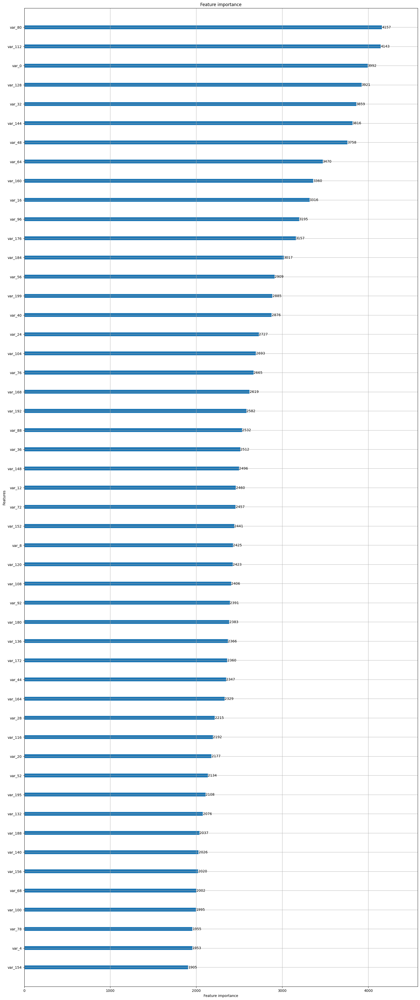

In [78]:
lgb.plot_importance(lgbm, max_num_features= 50, importance_type= "split", figsize= (20, 50))
plt.savefig(
    os.path.join(save_dir, "plot_imp_features_using_lgbm.png")
)

*Conclusion- We have tried with different model like Logistic Regression , SMOTE and LightGBM. But we observed that LightGBM is performing well on imbalanced data as compared to other models based on the roc_auc_scores.*

In [79]:
#Final Submission
df_sub= pd.DataFrame({"ID_code": df_test["ID_code"].values})
df_sub["lgbm_predict_prob"]= lgbm_predict_prob
df_sub["lgbm_predict"]= lgbm_predict
df_sub.to_csv("submission.csv", index= False)
df_sub.head()

,ID_code,lgbm_predict_prob,lgbm_predict
0,test_0,0.296878,0
1,test_1,0.515192,1
2,test_2,0.382054,0
3,test_3,0.586040,1
4,test_4,0.131466,0
